<a href="https://colab.research.google.com/github/Firmnsyaah/Batik-Nusantara/blob/main/Copy_of_Bismillah_jadi.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import tensorflow as tf

print(tf.__version__)

physical_devices = tf.config.list_physical_devices('GPU')
print("GPUs Available: ", physical_devices)

if physical_devices:
    # Allow memory growth for the GPU
    try:
        for gpu in physical_devices:
            tf.config.experimental.set_memory_growth(gpu, True)
    except RuntimeError as e:
        print(e)

2.10.1
GPUs Available:  [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [2]:
import os
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input
import matplotlib.pyplot as plt
# from google.colab import drive

In [3]:
# drive.mount('/content/drive')

In [4]:
DATA_DIR = 'dataset'
MODEL_DIR = 'model'
IMAGE_WIDTH = 224
IMAGE_HEIGHT = 224
BATCH_SIZE = 64
GPU_DEVICE = '/GPU:0'

In [5]:
import numpy as np

# Fungsi untuk menambahkan Gaussian noise
def add_gaussian_noise(img, mean=0.0, std=0.1):
    noise = np.random.normal(mean, std, img.shape)
    img = img + noise
    img = np.clip(img, 0., 1.)  # Untuk memastikan nilai tetap dalam rentang [0, 1]
    return img

# Data augmentation untuk dataset pelatihan
train_datagen = ImageDataGenerator(
    preprocessing_function=lambda img: add_gaussian_noise(preprocess_input(img)),  # Preprocessing dengan noise
    rotation_range=40,
    width_shift_range=0.3,
    height_shift_range=0.3,
    shear_range=0.3,
    zoom_range=0.3,
    horizontal_flip=True,
    vertical_flip=True,
    brightness_range=[0.7, 1.3],
    channel_shift_range=0.2,
    fill_mode='nearest',
)

# Data generator untuk dataset validasi dan pengujian (tanpa augmentasi, hanya preprocessing)
test_val_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)

# Membuat generator untuk data pelatihan
train_generator = train_datagen.flow_from_directory(
    directory=os.path.join(DATA_DIR, 'Train'),  # Ubah 'TRAIN' sesuai dengan direktori pelatihanmu
    target_size=(IMAGE_HEIGHT, IMAGE_WIDTH),
    color_mode='rgb',
    class_mode='categorical',
    batch_size=BATCH_SIZE,
    shuffle=True
)

# Membuat generator untuk data validasi
validation_generator = test_val_datagen.flow_from_directory(
    directory=os.path.join(DATA_DIR, 'Validation'),  # Ubah 'VALIDATION' sesuai dengan direktori validasimu
    target_size=(IMAGE_HEIGHT, IMAGE_WIDTH),
    color_mode='rgb',
    class_mode='categorical',
    batch_size=BATCH_SIZE,
    shuffle=False
)

# Membuat generator untuk data pengujian
test_generator = test_val_datagen.flow_from_directory(
    directory=os.path.join(DATA_DIR, 'Test'),  # Ubah 'TEST' sesuai dengan direktori pengujianmu
    target_size=(IMAGE_HEIGHT, IMAGE_WIDTH),
    color_mode='rgb',
    class_mode='categorical',
    batch_size=BATCH_SIZE,
    shuffle=False
)

Found 946 images belonging to 19 classes.
Found 113 images belonging to 19 classes.
Found 114 images belonging to 19 classes.


#Evaluasi Model MobileNetV2


In [6]:
import tensorflow as tf
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.layers import GlobalAveragePooling2D, Dense, Dropout
from tensorflow.keras import Input
from tensorflow.keras.regularizers import l2
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
# Tentukan IMAGE_HEIGHT dan IMAGE_WIDTH
IMAGE_HEIGHT = 224
IMAGE_WIDTH = 224

# Pastikan 'train_generator' sudah didefinisikan dan memuat data
num_classes = train_generator.num_classes  # Memastikan jumlah kelas sudah benar

# Load pre-trained MobileNetV2 model dengan weights dari ImageNet
input_tensor = Input(shape=(IMAGE_HEIGHT, IMAGE_WIDTH, 3))
base_model = MobileNetV2(input_tensor=input_tensor,
                         include_top=False,
                         weights='imagenet')

# Periksa output shape dari base model
print(f'Output shape dari MobileNetV2: {base_model.output_shape}')

# ***Step 1: Bekukan semua layer dari base model terlebih dahulu***
for layer in base_model.layers:
    layer.trainable = False  # Membekukan semua layer pre-trained

# Tambahkan custom layers di atas base model (menggunakan Functional API)
x = base_model.output
x = GlobalAveragePooling2D()(x)  # Layer pooling global
x = Dense(256, activation='relu', kernel_regularizer=l2(0.01))(x)  # Dense layer dengan L2 regularization
x = Dropout(0.5)(x)  # Dropout untuk mencegah overfitting
output_layer = Dense(num_classes, activation='softmax')(x)  # Layer output sesuai dengan jumlah kelas

# Buat model menggunakan Functional API
model = tf.keras.Model(inputs=input_tensor, outputs=output_layer)

# Kompilasi model dengan optimizer dan loss function yang sesuai
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# Menampilkan ringkasan model
model.summary()

Output shape dari MobileNetV2: (None, 7, 7, 1280)
Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv1 (Conv2D)                 (None, 112, 112, 32  864         ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 bn_Conv1 (BatchNormalization)  (None, 112, 112, 32  128         ['Conv1[0][0]']                  
                                )           

#Epoch


In [7]:
# ***Step 2: Latih model dengan layer baru saja (base model dibekukan)***
with tf.device(GPU_DEVICE):
    history = model.fit(train_generator,
                        epochs=10,  # Latih untuk beberapa epoch (misalnya 10)
                        validation_data=validation_generator,
                        batch_size=BATCH_SIZE)

# ***Step 3: Setelah beberapa epoch, buka beberapa layer terakhir untuk fine-tuning***
for layer in base_model.layers[-15:]:  # Membuka 15 layer terakhir untuk fine-tuning
    layer.trainable = True

# Kompilasi ulang model setelah membuka beberapa layer terakhir
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4),  # Gunakan learning rate yang sedikit lebih rendah
              loss='categorical_crossentropy',
              metrics=['accuracy'])

Epoch 1/10


C:\Users\fazan\.conda\envs\batik-env-3.10\lib\site-packages\PIL\Image.py:1056: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


15/15 [==============================] - 20s 1s/step - loss: 6.9620 - accuracy: 0.1596 - val_loss: 5.9858 - val_accuracy: 0.3363
Epoch 2/10
15/15 [==============================] - 16s 1s/step - loss: 5.7100 - accuracy: 0.2907 - val_loss: 5.0341 - val_accuracy: 0.4071
Epoch 3/10
15/15 [==============================] - 16s 1s/step - loss: 4.7684 - accuracy: 0.4049 - val_loss: 4.2681 - val_accuracy: 0.4779
Epoch 4/10
15/15 [==============================] - 16s 1s/step - loss: 4.2152 - accuracy: 0.4493 - val_loss: 3.8017 - val_accuracy: 0.5133
Epoch 5/10
15/15 [==============================] - 16s 1s/step - loss: 3.7164 - accuracy: 0.4841 - val_loss: 3.4921 - val_accuracy: 0.4956
Epoch 6/10
15/15 [==============================] - 16s 1s/step - loss: 3.3713 - accuracy: 0.5233 - val_loss: 3.1714 - val_accuracy: 0.5221
Epoch 7/10
15/15 [==============================] - 17s 1s/step - loss: 3.0970 - accuracy: 0.5359 - val_loss: 3.0146 - val_accuracy: 0.5487
Epoch 8/10
15/15 [=============

In [8]:
test_loss, test_accuracy = model.evaluate(test_generator)
print(f'Test Accuracy: {test_accuracy:.2f}')
print(f'Test Loss: {test_loss:.4f}')

2/2 [==============================] - 1s 245ms/step - loss: 2.5142 - accuracy: 0.5526
Test Accuracy: 0.55
Test Loss: 2.5142


In [9]:
# Fine-tuning menggunakan data pelatihan dan validasi
with tf.device(GPU_DEVICE):
    history_fine = model.fit(train_generator,
                             epochs=15,  # Latih selama 15 epoch
                             validation_data=validation_generator, # Ganti test_generator dengan validation_generator
                             batch_size=BATCH_SIZE)

# Callback untuk fine-tuning
callbacks = [
    EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True),
    ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=1e-6)
]

# Fine-tuning lanjutan dengan callback
with tf.device(GPU_DEVICE):
    history_fine = model.fit(train_generator,
                             epochs=20,  # Tambahkan epoch untuk fine-tuning
                             validation_data=validation_generator,  # Ganti test_generator dengan validation_generator
                             callbacks=callbacks,
                             batch_size=BATCH_SIZE)

Epoch 1/15
15/15 [==============================] - 18s 1s/step - loss: 2.8362 - accuracy: 0.4852 - val_loss: 2.4999 - val_accuracy: 0.5487
Epoch 2/15
15/15 [==============================] - 17s 1s/step - loss: 2.5368 - accuracy: 0.5983 - val_loss: 2.5495 - val_accuracy: 0.5841
Epoch 3/15
15/15 [==============================] - 16s 1s/step - loss: 2.3824 - accuracy: 0.6184 - val_loss: 2.4896 - val_accuracy: 0.5487
Epoch 4/15
15/15 [==============================] - 16s 1s/step - loss: 2.2674 - accuracy: 0.6364 - val_loss: 2.5080 - val_accuracy: 0.5575
Epoch 5/15
15/15 [==============================] - 16s 1s/step - loss: 2.1473 - accuracy: 0.6554 - val_loss: 2.3967 - val_accuracy: 0.5664
Epoch 6/15
15/15 [==============================] - 16s 1s/step - loss: 2.1244 - accuracy: 0.6670 - val_loss: 2.3396 - val_accuracy: 0.6018
Epoch 7/15
15/15 [==============================] - 16s 1s/step - loss: 2.0665 - accuracy: 0.6913 - val_loss: 2.4568 - val_accuracy: 0.5752
Epoch 8/15
15/15 [==

In [10]:
test_loss, test_accuracy = model.evaluate(test_generator)
print(f'Test Accuracy: {test_accuracy:.2f}')
print(f'Test Loss: {test_loss:.4f}')

2/2 [==============================] - 1s 251ms/step - loss: 2.3460 - accuracy: 0.6930
Test Accuracy: 0.69
Test Loss: 2.3460


In [11]:
test_loss, test_accuracy = model.evaluate(test_generator)
print(f'Test Accuracy: {test_accuracy:.2f}')
print(f'Test Loss: {test_loss:.4f}')

2/2 [==============================] - 1s 257ms/step - loss: 2.3460 - accuracy: 0.6930
Test Accuracy: 0.69
Test Loss: 2.3460


In [12]:
from tensorflow.keras.callbacks import ModelCheckpoint, LearningRateScheduler

# Learning rate scheduler function
def scheduler(epoch, lr):
    if epoch < 10:
        return lr
    else:
        return lr * 0.1  # Turunkan learning rate setelah 10 epoch

# Callback ModelCheckpoint untuk menyimpan model terbaik secara otomatis berdasarkan val_loss
checkpoint = ModelCheckpoint('model/Batik_Nusantara_best_model.keras',
                             monitor='val_loss',
                             save_best_only=True,  # Hanya simpan model terbaik
                             save_weights_only=False,  # Simpan seluruh model, bukan hanya bobot
                             mode='min',  # Memonitor untuk menurunkan val_loss (minimizing)
                             verbose=1)

# Callback list with ModelCheckpoint and LearningRateScheduler
callbacks = [
    EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True),
    ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=1e-6),
    LearningRateScheduler(scheduler),
    checkpoint  # Tambahkan ModelCheckpoint ke callbacks
]

# Fine-tuning lebih mendalam dengan epoch lebih banyak
with tf.device(GPU_DEVICE):
    history_fine = model.fit(train_generator,
                             epochs=50,  # Naikkan epoch untuk fine-tuning
                             validation_data=validation_generator,
                             callbacks=callbacks,
                             batch_size=BATCH_SIZE)

# Evaluasi model setelah fine-tuning
test_loss, test_accuracy = model.evaluate(test_generator)
print(f'Test Accuracy: {test_accuracy:.2f}')
print(f'Test Loss: {test_loss:.4f}')

Epoch 1/50
15/15 [==============================] - ETA: 0s - loss: 1.3343 - accuracy: 0.8467
Epoch 1: val_loss improved from inf to 1.94651, saving model to model\Batik_Nusantara_best_model.keras
15/15 [==============================] - 16s 1s/step - loss: 1.3343 - accuracy: 0.8467 - val_loss: 1.9465 - val_accuracy: 0.6991 - lr: 2.0000e-05
Epoch 2/50
15/15 [==============================] - ETA: 0s - loss: 1.3251 - accuracy: 0.8383
Epoch 2: val_loss improved from 1.94651 to 1.93213, saving model to model\Batik_Nusantara_best_model.keras
15/15 [==============================] - 16s 1s/step - loss: 1.3251 - accuracy: 0.8383 - val_loss: 1.9321 - val_accuracy: 0.7080 - lr: 2.0000e-05
Epoch 3/50
15/15 [==============================] - ETA: 0s - loss: 1.3060 - accuracy: 0.8573
Epoch 3: val_loss improved from 1.93213 to 1.92741, saving model to model\Batik_Nusantara_best_model.keras
15/15 [==============================] - 16s 1s/step - loss: 1.3060 - accuracy: 0.8573 - val_loss: 1.9274 - v

2/2 [==============================] - 1s 280ms/step


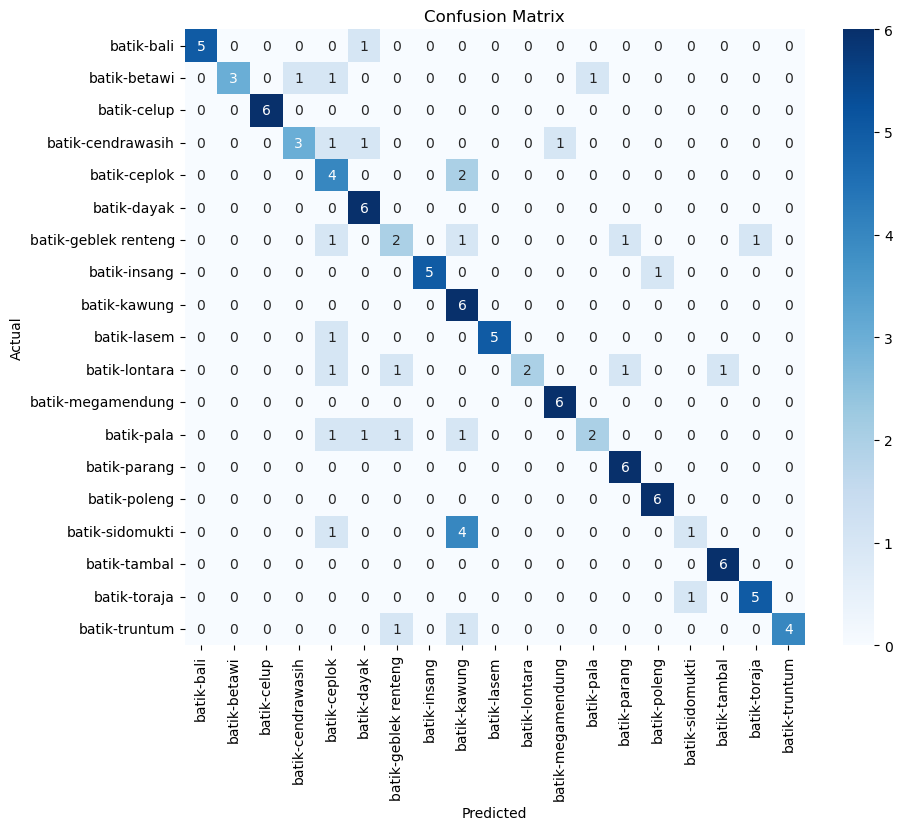

In [13]:
from sklearn.metrics import confusion_matrix, classification_report
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Mengambil prediksi dari data pengujian
Y_pred = model.predict(test_generator)
y_pred = np.argmax(Y_pred, axis=1)

# Membuat Confusion Matrix
cm = confusion_matrix(test_generator.classes, y_pred)

# Visualisasi Confusion Matrix
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=test_generator.class_indices.keys(), yticklabels=test_generator.class_indices.keys())
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

2/2 [==============================] - 1s 246ms/step

Gambar Salah Klasifikasi dan Duplikatnya (jika ada) pada Test Set:

Gambar: dataset\Test\batik-bali\image (3).jpg
 - Label Asli: batik-bali
 - Prediksi: batik-dayak


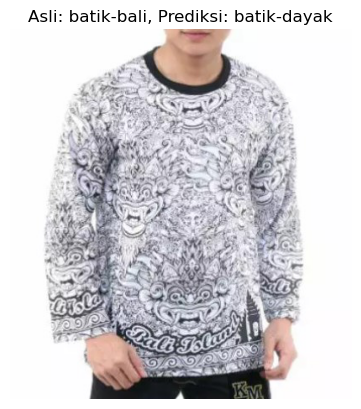


Gambar: dataset\Test\batik-betawi\image (1).jpg
 - Label Asli: batik-betawi
 - Prediksi: batik-pala


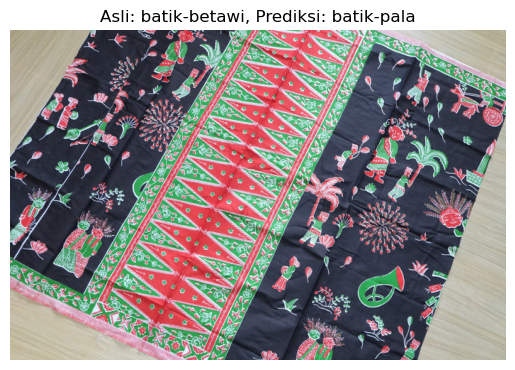


Gambar: dataset\Test\batik-betawi\image (2).jpg
 - Label Asli: batik-betawi
 - Prediksi: batik-ceplok


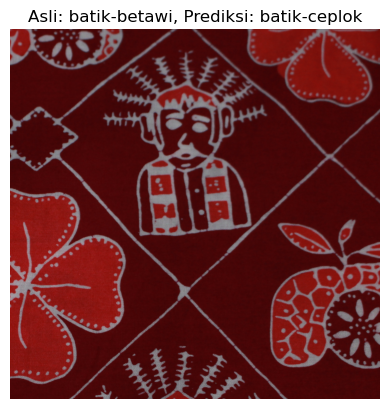


Gambar: dataset\Test\batik-betawi\image (4).jpg
 - Label Asli: batik-betawi
 - Prediksi: batik-cendrawasih


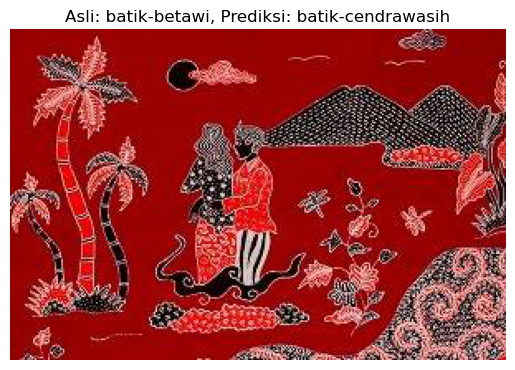


Gambar: dataset\Test\batik-cendrawasih\456567dfefc314289a3cd5638575bea2.jpg
 - Label Asli: batik-cendrawasih
 - Prediksi: batik-ceplok


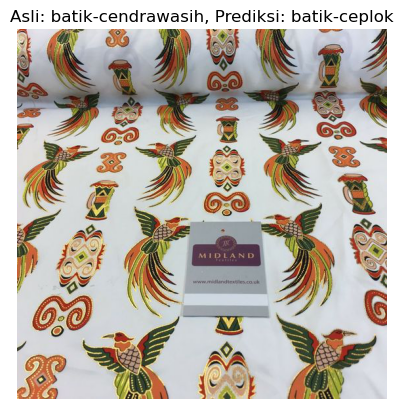


Gambar: dataset\Test\batik-cendrawasih\Screenshot 2024-10-18 163034.jpg
 - Label Asli: batik-cendrawasih
 - Prediksi: batik-dayak


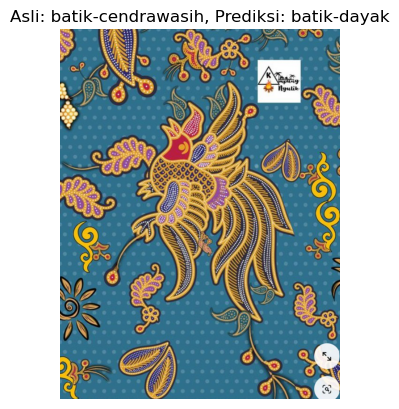


Gambar: dataset\Test\batik-cendrawasih\image (42).jpg
 - Label Asli: batik-cendrawasih
 - Prediksi: batik-megamendung


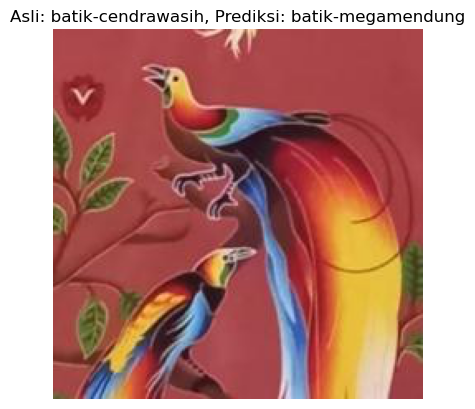


Gambar: dataset\Test\batik-ceplok\image (2).jpg
 - Label Asli: batik-ceplok
 - Prediksi: batik-kawung


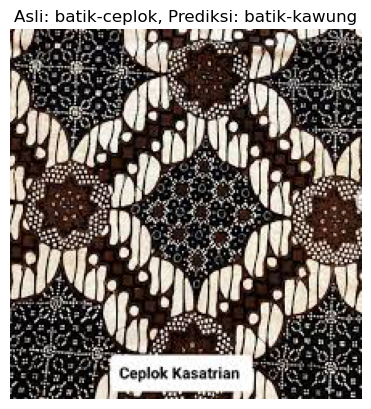


Gambar: dataset\Test\batik-ceplok\image (6).jpg
 - Label Asli: batik-ceplok
 - Prediksi: batik-kawung


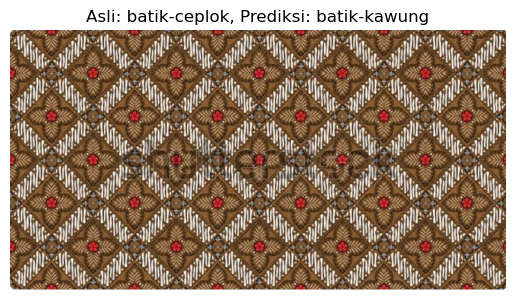


Gambar: dataset\Test\batik-geblek renteng\d (16).jpg
 - Label Asli: batik-geblek renteng
 - Prediksi: batik-kawung


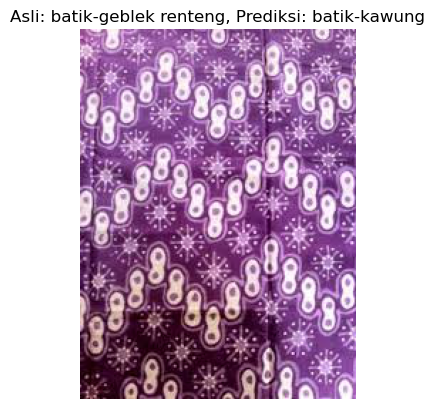


Gambar: dataset\Test\batik-geblek renteng\d (17).jpg
 - Label Asli: batik-geblek renteng
 - Prediksi: batik-ceplok


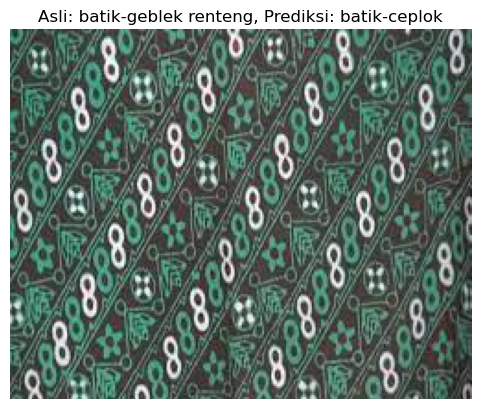


Gambar: dataset\Test\batik-geblek renteng\image (3).jpg
 - Label Asli: batik-geblek renteng
 - Prediksi: batik-toraja


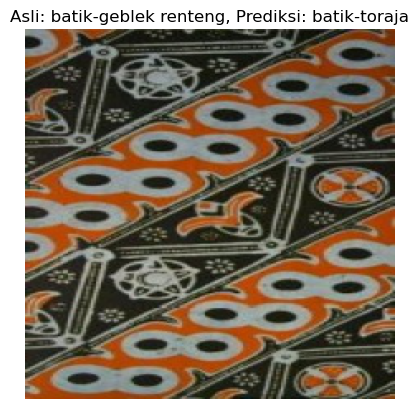


Gambar: dataset\Test\batik-geblek renteng\image (4).jpg
 - Label Asli: batik-geblek renteng
 - Prediksi: batik-parang


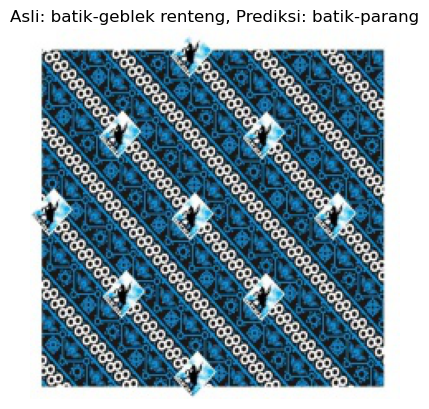


Gambar: dataset\Test\batik-insang\d (30).jpg
 - Label Asli: batik-insang
 - Prediksi: batik-poleng


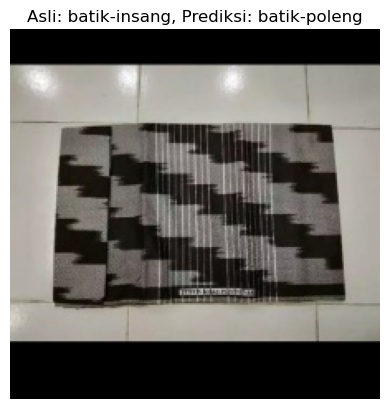


Gambar: dataset\Test\batik-lasem\s (20).jpg
 - Label Asli: batik-lasem
 - Prediksi: batik-ceplok


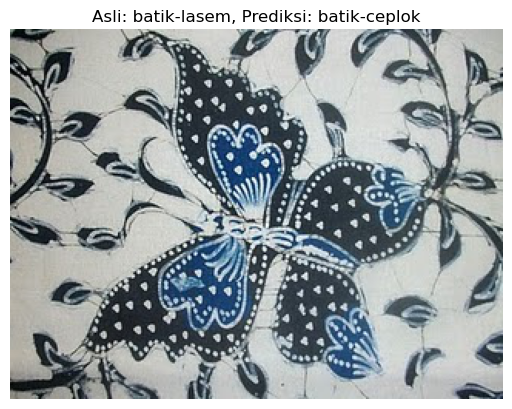


Gambar: dataset\Test\batik-lontara\d (15).jpg
 - Label Asli: batik-lontara
 - Prediksi: batik-geblek renteng


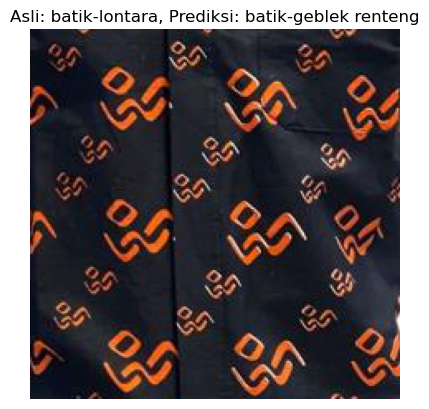


Gambar: dataset\Test\batik-lontara\d (21).jpg
 - Label Asli: batik-lontara
 - Prediksi: batik-parang


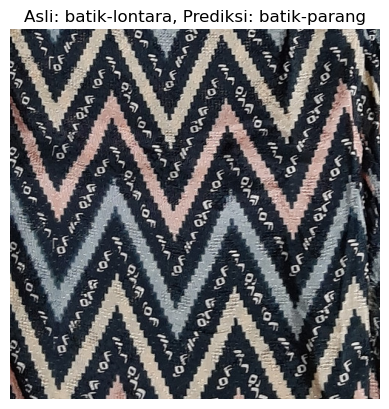


Gambar: dataset\Test\batik-lontara\d (9).jpg
 - Label Asli: batik-lontara
 - Prediksi: batik-ceplok


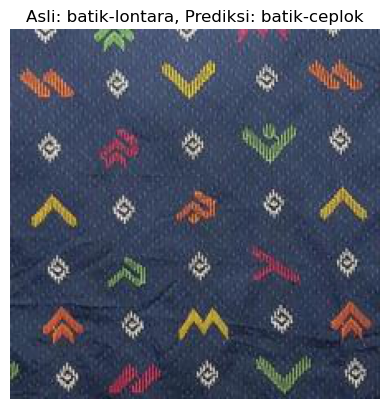


Gambar: dataset\Test\batik-lontara\image (4).jpg
 - Label Asli: batik-lontara
 - Prediksi: batik-tambal


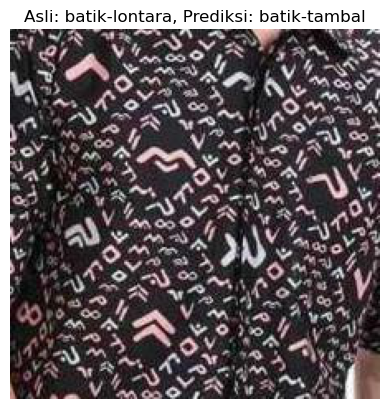


Gambar: dataset\Test\batik-pala\image (10).jpg
 - Label Asli: batik-pala
 - Prediksi: batik-kawung
 - Duplikat Ditemukan:
   - dataset\Validation\batik-pala\s (14).jpg


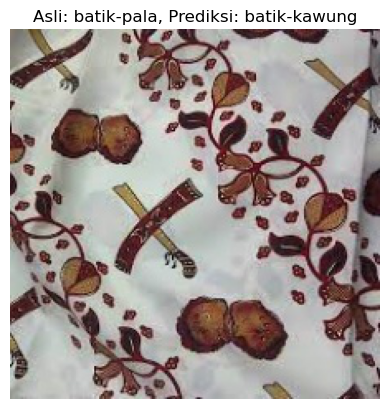


Gambar: dataset\Test\batik-pala\image (3).jpg
 - Label Asli: batik-pala
 - Prediksi: batik-dayak


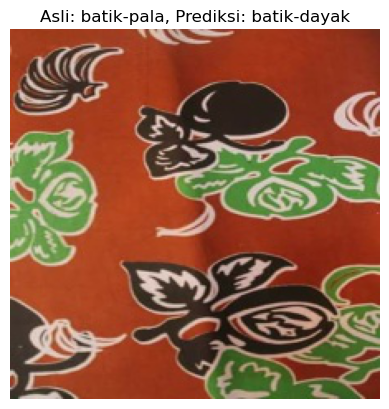


Gambar: dataset\Test\batik-pala\image (9).jpg
 - Label Asli: batik-pala
 - Prediksi: batik-geblek renteng


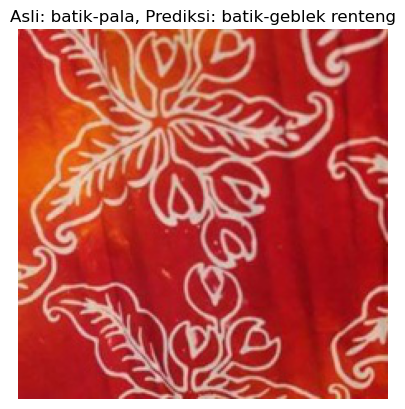


Gambar: dataset\Test\batik-pala\s (43).jpg
 - Label Asli: batik-pala
 - Prediksi: batik-ceplok


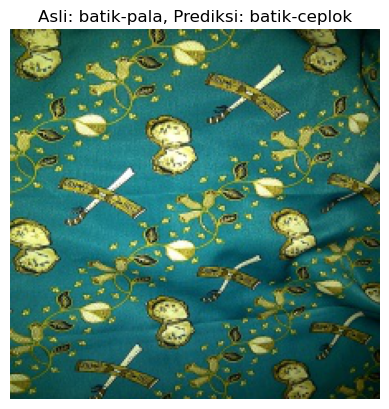


Gambar: dataset\Test\batik-sidomukti\s (21).jpg
 - Label Asli: batik-sidomukti
 - Prediksi: batik-kawung


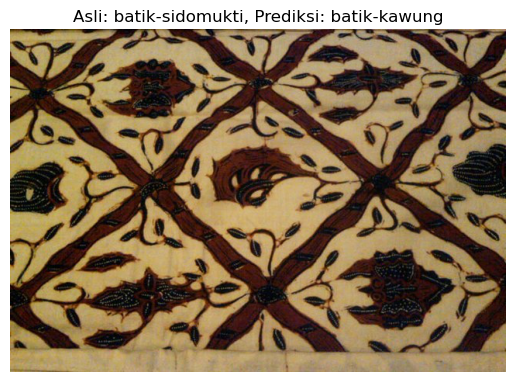


Gambar: dataset\Test\batik-sidomukti\s (24).jpg
 - Label Asli: batik-sidomukti
 - Prediksi: batik-kawung


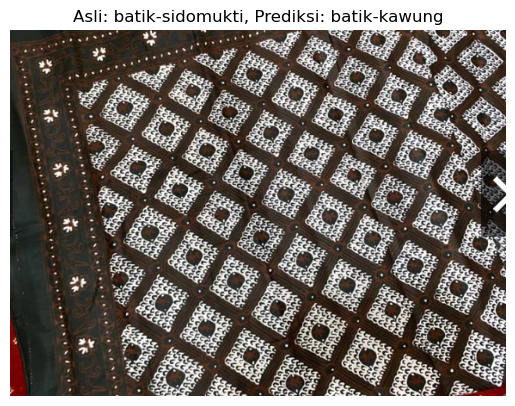


Gambar: dataset\Test\batik-sidomukti\s (30).jpg
 - Label Asli: batik-sidomukti
 - Prediksi: batik-kawung


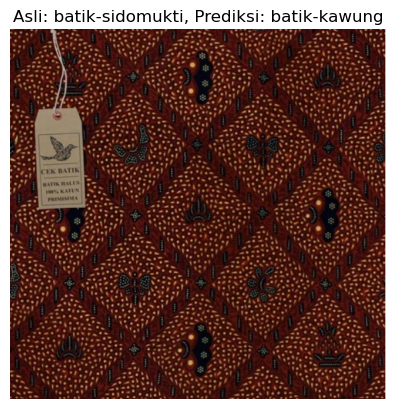


Gambar: dataset\Test\batik-sidomukti\s (33).jpg
 - Label Asli: batik-sidomukti
 - Prediksi: batik-ceplok


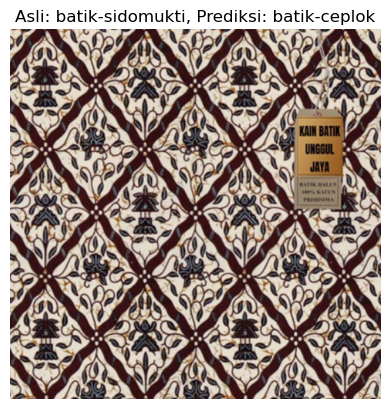


Gambar: dataset\Test\batik-sidomukti\s (34).jpg
 - Label Asli: batik-sidomukti
 - Prediksi: batik-kawung


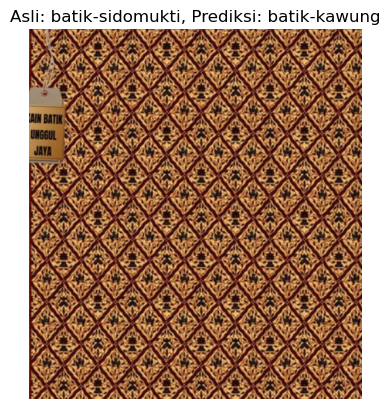


Gambar: dataset\Test\batik-toraja\IMG-20241018-WA0059.jpg
 - Label Asli: batik-toraja
 - Prediksi: batik-sidomukti


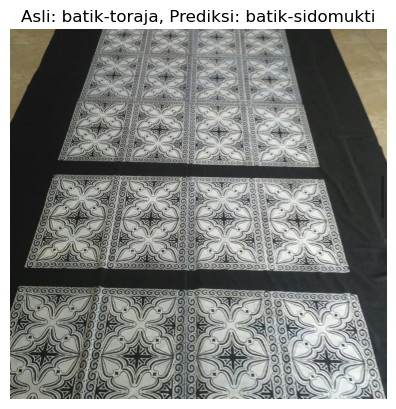


Gambar: dataset\Test\batik-truntum\a (16).jpg
 - Label Asli: batik-truntum
 - Prediksi: batik-kawung


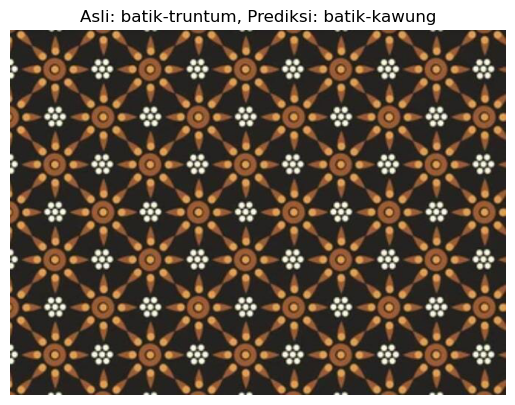


Gambar: dataset\Test\batik-truntum\a (5).jpg
 - Label Asli: batik-truntum
 - Prediksi: batik-geblek renteng


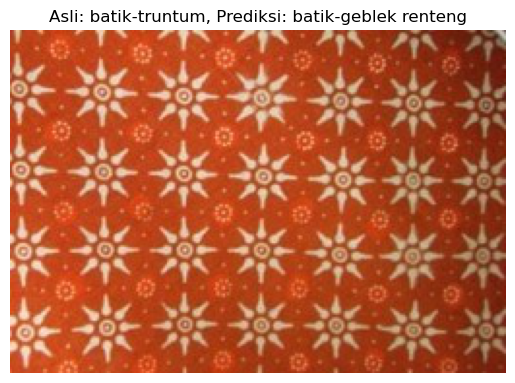

C:\Users\fazan\.conda\envs\batik-env-3.10\lib\site-packages\PIL\Image.py:1056: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


2/2 [==============================] - 1s 285ms/step

Gambar Salah Klasifikasi dan Duplikatnya (jika ada) pada Validation Set:

Gambar: dataset\Validation\batik-bali\614eaa8f-5535-4627-beca-b38b67d5d4b9.jpg
 - Label Asli: batik-bali
 - Prediksi: batik-betawi
 - Duplikat Ditemukan:
   - dataset\Train\batik-bali\Validation\614eaa8f-5535-4627-beca-b38b67d5d4b9.jpg


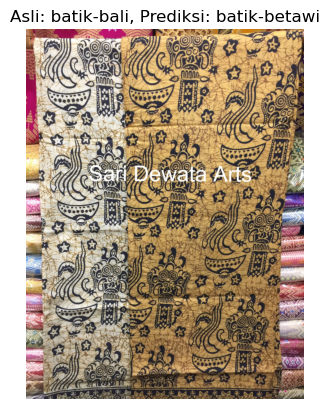


Gambar: dataset\Validation\batik-betawi\image (20).jpg
 - Label Asli: batik-betawi
 - Prediksi: batik-dayak


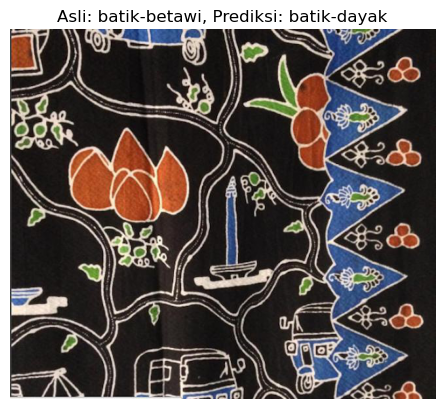


Gambar: dataset\Validation\batik-betawi\image (51).jpg
 - Label Asli: batik-betawi
 - Prediksi: batik-dayak


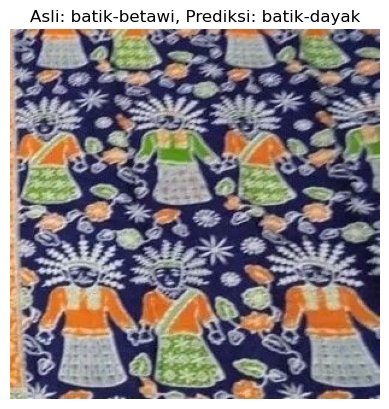


Gambar: dataset\Validation\batik-cendrawasih\image (3).jpg
 - Label Asli: batik-cendrawasih
 - Prediksi: batik-ceplok


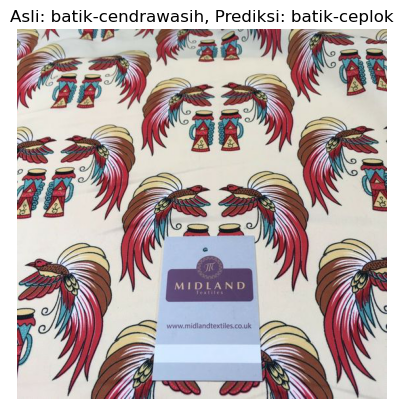


Gambar: dataset\Validation\batik-ceplok\image (5).jpg
 - Label Asli: batik-ceplok
 - Prediksi: batik-kawung


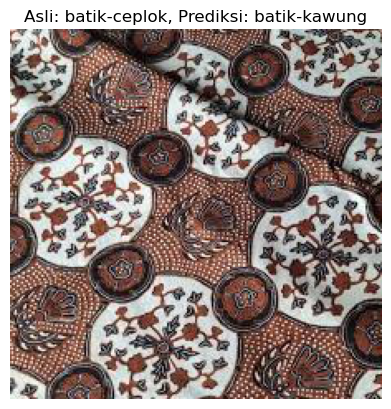


Gambar: dataset\Validation\batik-dayak\89.jpg
 - Label Asli: batik-dayak
 - Prediksi: batik-kawung
 - Duplikat Ditemukan:
   - dataset\Train\batik-dayak\p (17).jpg


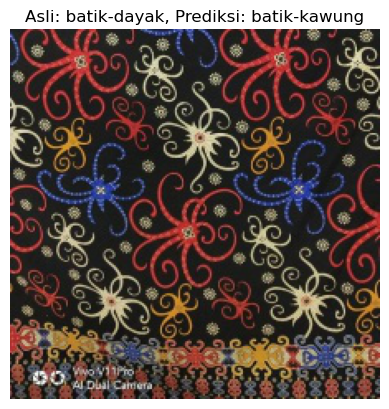


Gambar: dataset\Validation\batik-geblek renteng\d (15).jpg
 - Label Asli: batik-geblek renteng
 - Prediksi: batik-parang


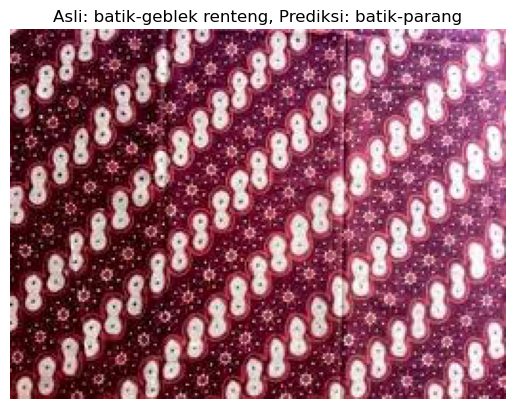


Gambar: dataset\Validation\batik-geblek renteng\d (21).jpg
 - Label Asli: batik-geblek renteng
 - Prediksi: batik-parang


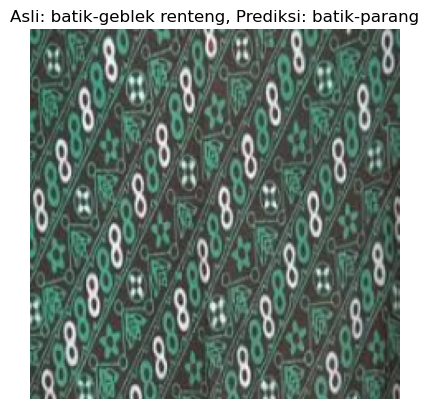


Gambar: dataset\Validation\batik-geblek renteng\d (26).jpg
 - Label Asli: batik-geblek renteng
 - Prediksi: batik-parang


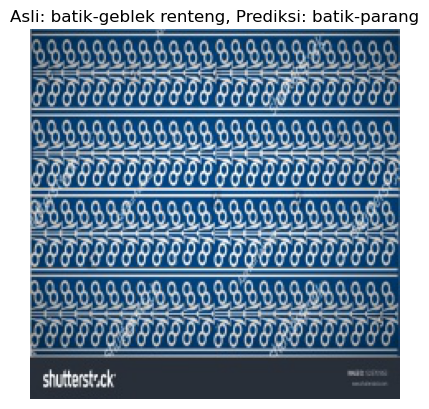


Gambar: dataset\Validation\batik-geblek renteng\d (27).jpg
 - Label Asli: batik-geblek renteng
 - Prediksi: batik-parang


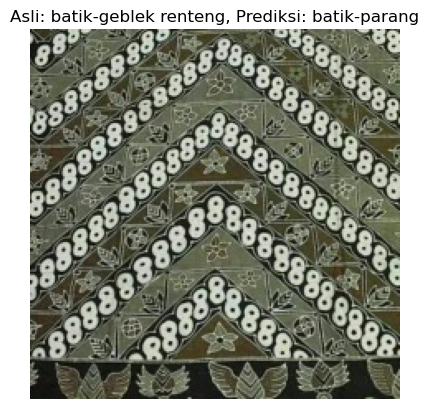


Gambar: dataset\Validation\batik-kawung\ceplok (35).jpg
 - Label Asli: batik-kawung
 - Prediksi: batik-toraja


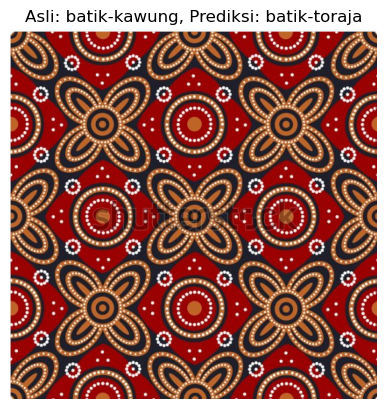


Gambar: dataset\Validation\batik-lasem\image (12).jpg
 - Label Asli: batik-lasem
 - Prediksi: batik-cendrawasih


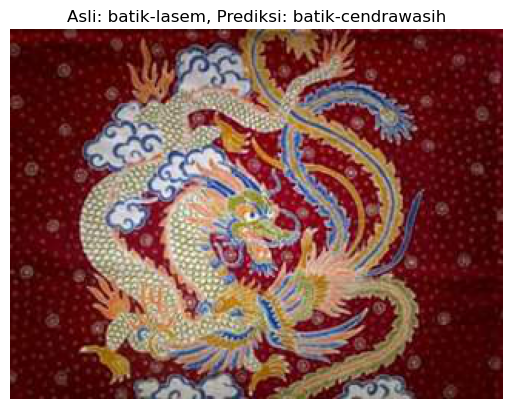


Gambar: dataset\Validation\batik-lasem\s (2).jpg
 - Label Asli: batik-lasem
 - Prediksi: batik-kawung


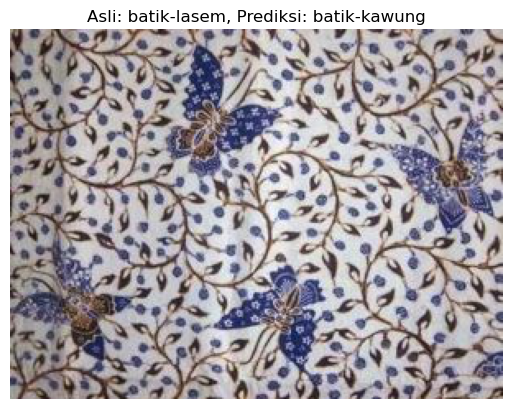


Gambar: dataset\Validation\batik-lasem\s (34).jpg
 - Label Asli: batik-lasem
 - Prediksi: batik-dayak


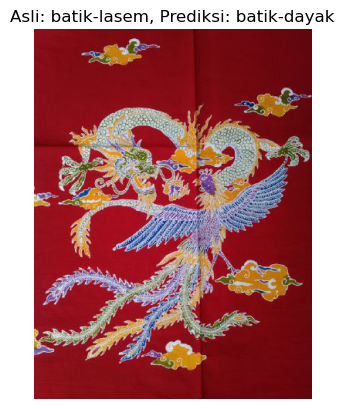


Gambar: dataset\Validation\batik-lasem\s (48).jpg
 - Label Asli: batik-lasem
 - Prediksi: batik-parang


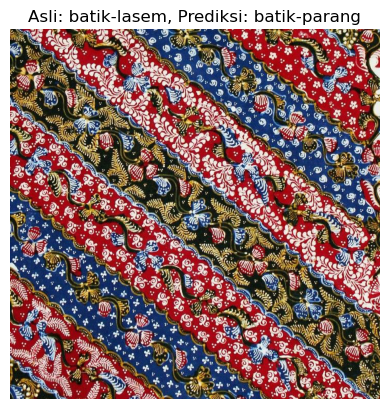


Gambar: dataset\Validation\batik-lontara\d (23).jpg
 - Label Asli: batik-lontara
 - Prediksi: batik-tambal


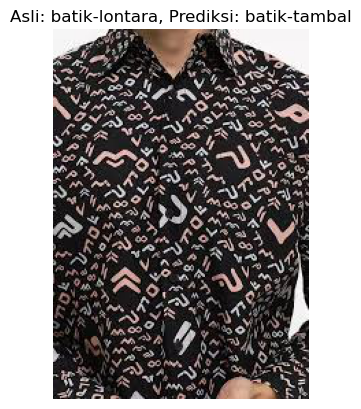


Gambar: dataset\Validation\batik-lontara\image (5).jpg
 - Label Asli: batik-lontara
 - Prediksi: batik-bali


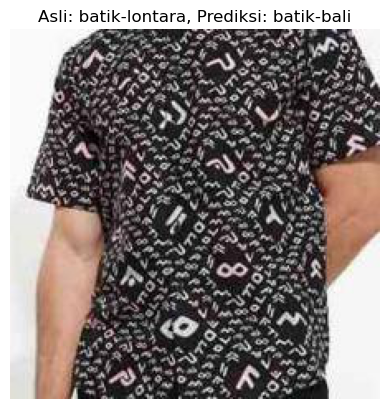


Gambar: dataset\Validation\batik-pala\s (14).jpg
 - Label Asli: batik-pala
 - Prediksi: batik-kawung
 - Duplikat Ditemukan:
   - dataset\Test\batik-pala\image (10).jpg


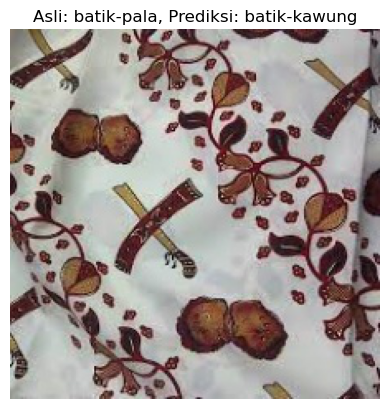


Gambar: dataset\Validation\batik-pala\s (18).jpg
 - Label Asli: batik-pala
 - Prediksi: batik-dayak


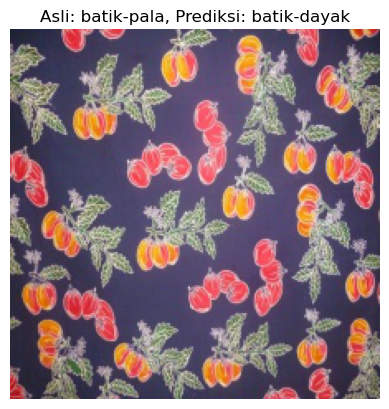


Gambar: dataset\Validation\batik-pala\s (30).jpg
 - Label Asli: batik-pala
 - Prediksi: batik-dayak


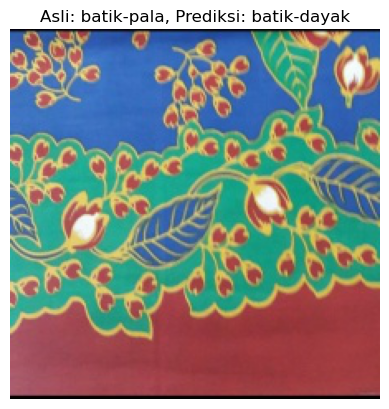


Gambar: dataset\Validation\batik-pala\s (5).jpg
 - Label Asli: batik-pala
 - Prediksi: batik-truntum


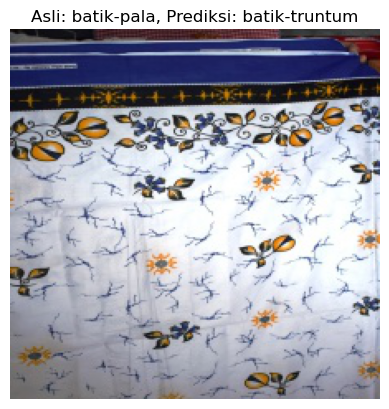


Gambar: dataset\Validation\batik-parang\image (7).jpg
 - Label Asli: batik-parang
 - Prediksi: batik-poleng


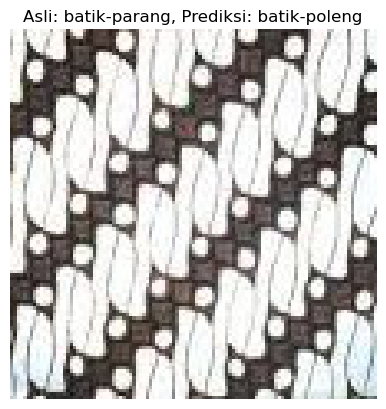


Gambar: dataset\Validation\batik-sidomukti\s (26).jpg
 - Label Asli: batik-sidomukti
 - Prediksi: batik-kawung


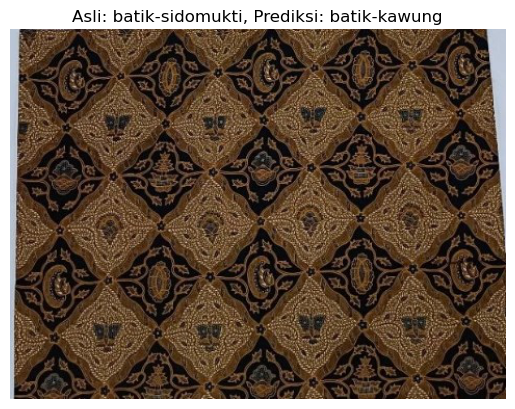


Gambar: dataset\Validation\batik-sidomukti\s (28).jpg
 - Label Asli: batik-sidomukti
 - Prediksi: batik-ceplok


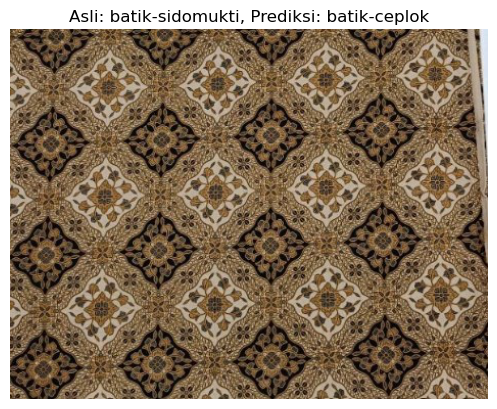


Gambar: dataset\Validation\batik-sidomukti\s (35).jpg
 - Label Asli: batik-sidomukti
 - Prediksi: batik-ceplok


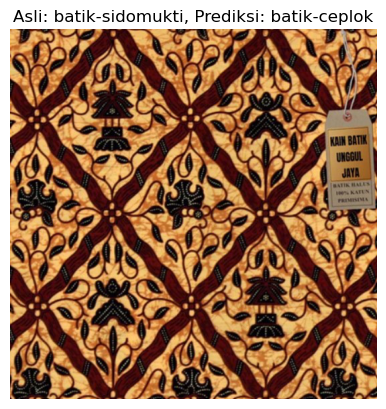


Gambar: dataset\Validation\batik-sidomukti\s (36).jpg
 - Label Asli: batik-sidomukti
 - Prediksi: batik-ceplok


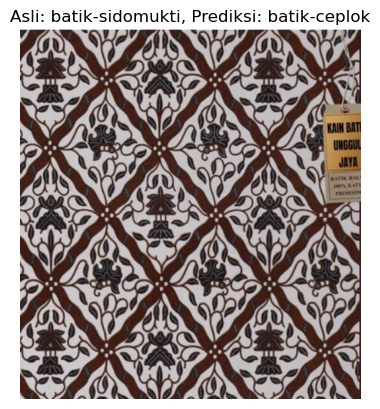


Gambar: dataset\Validation\batik-sidomukti\s (37).jpg
 - Label Asli: batik-sidomukti
 - Prediksi: batik-ceplok
 - Duplikat Ditemukan:
   - dataset\Train\batik-sidomukti\s (37).jpg


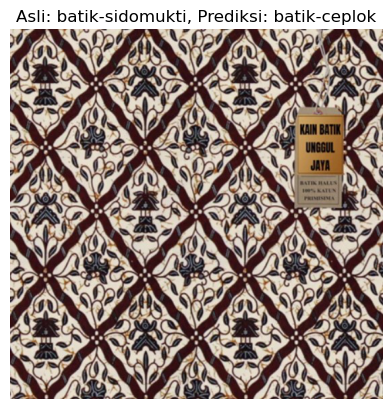


Gambar: dataset\Validation\batik-toraja\182f9e5d14f67822f66c00bcae9db4fa.jpg
 - Label Asli: batik-toraja
 - Prediksi: batik-kawung


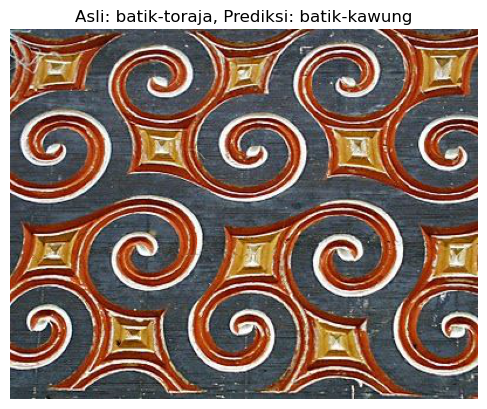


Gambar: dataset\Validation\batik-toraja\IMG-20241018-WA0060.jpg
 - Label Asli: batik-toraja
 - Prediksi: batik-sidomukti


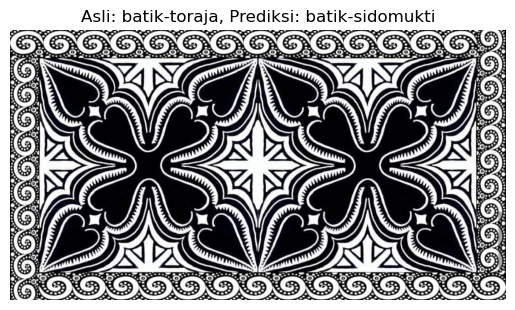


Gambar: dataset\Validation\batik-toraja\c8d666eb19368ae163862fb90f6d8fb1.jpg
 - Label Asli: batik-toraja
 - Prediksi: batik-ceplok


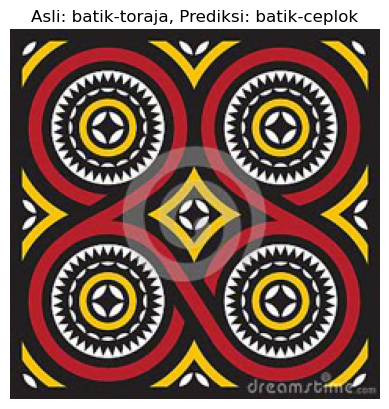


Gambar: dataset\Validation\batik-truntum\a (37).jpg
 - Label Asli: batik-truntum
 - Prediksi: batik-parang


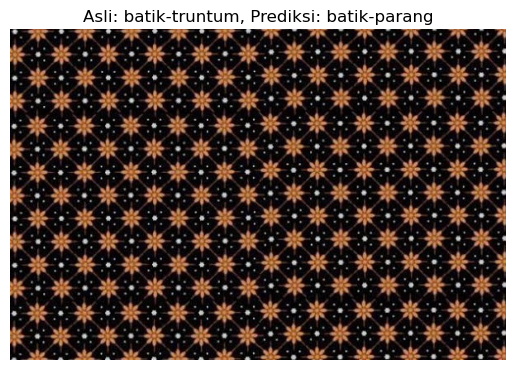

In [14]:
import os
import hashlib
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from collections import defaultdict

# Fungsi untuk menghitung hash gambar
def hash_image(image_path):
    with open(image_path, 'rb') as f:
        return hashlib.md5(f.read()).hexdigest()

# Memproses test set
def process_dataset(generator, set_name='Test'):
    # Mendapatkan prediksi dan label asli
    Y_pred = model.predict(generator)
    y_pred = np.argmax(Y_pred, axis=1)
    y_true = generator.classes
    class_labels = list(generator.class_indices.keys())

    # Indeks gambar yang salah klasifikasi
    incorrect_indices = np.where(y_pred != y_true)[0]

    # Dictionary untuk menyimpan hash dan path gambar
    hash_dict = defaultdict(list)

    # Mengumpulkan hash setiap gambar di dalam dataset
    for root, dirs, files in os.walk(DATA_DIR):
        for file in files:
            if file.endswith(('.png', '.jpg', '.jpeg')):
                file_path = os.path.join(root, file)
                file_hash = hash_image(file_path)
                hash_dict[file_hash].append(file_path)

    # Menampilkan informasi gambar yang salah klasifikasi dan mencari duplikatnya
    print(f"\nGambar Salah Klasifikasi dan Duplikatnya (jika ada) pada {set_name} Set:")
    for i in incorrect_indices:
        file_path = generator.filepaths[i]
        true_label = class_labels[y_true[i]]
        predicted_label = class_labels[y_pred[i]]
        file_hash = hash_image(file_path)

        # Menampilkan informasi gambar yang salah klasifikasi
        print(f"\nGambar: {file_path}")
        print(f" - Label Asli: {true_label}")
        print(f" - Prediksi: {predicted_label}")

        # Mencari duplikat berdasarkan hash
        if file_hash in hash_dict:
            duplicate_paths = hash_dict[file_hash]
            if len(duplicate_paths) > 1:
                print(" - Duplikat Ditemukan:")
                for dup_path in duplicate_paths:
                    if dup_path != file_path:  # Menampilkan duplikat yang bukan file asli
                        print(f"   - {dup_path}")

        # Opsional: Menampilkan gambar
        img = mpimg.imread(file_path)
        plt.imshow(img)
        plt.title(f"Asli: {true_label}, Prediksi: {predicted_label}")
        plt.axis('off')
        plt.show()

# Proses untuk test set
process_dataset(test_generator, set_name='Test')

# Proses untuk validation set
process_dataset(validation_generator, set_name='Validation')


In [15]:
from sklearn.metrics import classification_report, confusion_matrix, f1_score, recall_score, precision_score
import numpy as np

# Prediksi pada data pengujian
Y_pred = model.predict(test_generator)
y_pred = np.argmax(Y_pred, axis=1)

# Menghitung Confusion Matrix
cm = confusion_matrix(test_generator.classes, y_pred)

# Laporan Klasifikasi (F1-Score, Precision, Recall)
print('Classification Report:')
print(classification_report(test_generator.classes, y_pred, target_names=test_generator.class_indices.keys()))

# Menghitung F1-Score, Precision, dan Recall secara keseluruhan (macro average)
f1 = f1_score(test_generator.classes, y_pred, average='macro')
recall = recall_score(test_generator.classes, y_pred, average='macro')
precision = precision_score(test_generator.classes, y_pred, average='macro')

print(f'Overall F1-Score: {f1:.2f}')
print(f'Overall Recall: {recall:.2f}')
print(f'Overall Precision: {precision:.2f}')

2/2 [==============================] - 1s 245ms/step
Classification Report:
                      precision    recall  f1-score   support

          batik-bali       1.00      0.83      0.91         6
        batik-betawi       1.00      0.50      0.67         6
         batik-celup       1.00      1.00      1.00         6
   batik-cendrawasih       0.75      0.50      0.60         6
        batik-ceplok       0.36      0.67      0.47         6
         batik-dayak       0.67      1.00      0.80         6
batik-geblek renteng       0.40      0.33      0.36         6
        batik-insang       1.00      0.83      0.91         6
        batik-kawung       0.40      1.00      0.57         6
         batik-lasem       1.00      0.83      0.91         6
       batik-lontara       1.00      0.33      0.50         6
   batik-megamendung       0.86      1.00      0.92         6
          batik-pala       0.67      0.33      0.44         6
        batik-parang       0.75      1.00      0.86    

In [16]:
test_loss, test_accuracy = model.evaluate(test_generator)
print(f'Test Accuracy: {test_accuracy:.2f}')
print(f'Test Loss: {test_loss:.4f}')

2/2 [==============================] - 1s 242ms/step - loss: 1.9069 - accuracy: 0.7281
Test Accuracy: 0.73
Test Loss: 1.9069


In [17]:
from tensorflow.keras.callbacks import LearningRateScheduler

# Learning rate scheduler function
def scheduler(epoch, lr):
    if epoch < 10:
        return lr
    else:
        return lr * 0.1  # Turunkan learning rate setelah 10 epoch

# Callback list with learning rate scheduler
callbacks = [
    EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True),
    ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=1e-6),
    LearningRateScheduler(scheduler)
]

# Fine-tuning lebih mendalam dengan epoch lebih banyak
with tf.device(GPU_DEVICE):
    history_fine = model.fit(train_generator,
                             epochs=50,  # Naikkan epoch untuk fine-tuning
                             validation_data=validation_generator,
                             callbacks=callbacks,
                             batch_size=BATCH_SIZE)

test_loss, test_accuracy = model.evaluate(test_generator)
print(f'Test Accuracy: {test_accuracy:.2f}')
print(f'Test Loss: {test_loss:.4f}')

Epoch 1/50
13/15 [=========================>....] - ETA: 2s - loss: 1.2684 - accuracy: 0.8545

C:\Users\fazan\.conda\envs\batik-env-3.10\lib\site-packages\PIL\Image.py:1056: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


15/15 [==============================] - 16s 1s/step - loss: 1.2760 - accuracy: 0.8510 - val_loss: 1.6695 - val_accuracy: 0.7257 - lr: 1.4013e-45
Epoch 2/50
15/15 [==============================] - 16s 1s/step - loss: 1.3282 - accuracy: 0.8457 - val_loss: 1.6673 - val_accuracy: 0.7345 - lr: 1.4013e-45
Epoch 3/50
15/15 [==============================] - 16s 1s/step - loss: 1.2923 - accuracy: 0.8689 - val_loss: 1.6649 - val_accuracy: 0.7345 - lr: 1.4013e-45
Epoch 4/50
15/15 [==============================] - 16s 1s/step - loss: 1.3094 - accuracy: 0.8562 - val_loss: 1.6627 - val_accuracy: 0.7345 - lr: 1.4013e-45
Epoch 5/50
15/15 [==============================] - 16s 1s/step - loss: 1.3270 - accuracy: 0.8351 - val_loss: 1.6605 - val_accuracy: 0.7345 - lr: 1.4013e-45
Epoch 6/50
15/15 [==============================] - 16s 1s/step - loss: 1.2611 - accuracy: 0.8605 - val_loss: 1.6584 - val_accuracy: 0.7345 - lr: 1.4013e-45
Epoch 7/50
15/15 [==============================] - 16s 1s/step - los

In [18]:
import os

# Cek isi dari direktori yang seharusnya menyimpan model
print(os.listdir('model'))

import sys
print("Python version")
print(sys.version)


['Batik_Nusantara_best_model.keras']
Python version
3.10.15 | packaged by Anaconda, Inc. | (main, Oct  3 2024, 07:22:19) [MSC v.1929 64 bit (AMD64)]


In [20]:
from tensorflow.keras.models import load_model

# Load model yang tersimpan pada checkpoint
model = load_model('model/Batik_Nusantara_best_model.keras')

In [21]:
# Fine-tuning menggunakan data pelatihan dan validasi
with tf.device(GPU_DEVICE):
    history_fine = model.fit(train_generator,
                             epochs=15,  # Latih selama 15 epoch
                             validation_data=validation_generator, # Ganti test_generator dengan validation_generator
                             batch_size=BATCH_SIZE)

# Callback untuk fine-tuning
callbacks = [
    EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True),
    ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=1e-6)
]

# Fine-tuning lanjutan dengan callback
with tf.device(GPU_DEVICE):
    history_fine = model.fit(train_generator,
                             epochs=20,  # Tambahkan epoch untuk fine-tuning
                             validation_data=validation_generator,  # Ganti test_generator dengan validation_generator
                             callbacks=callbacks,
                             batch_size=BATCH_SIZE)

Epoch 1/15
15/15 [==============================] - 17s 1s/step - loss: 1.2409 - accuracy: 0.8605 - val_loss: 1.6698 - val_accuracy: 0.7257
Epoch 2/15
15/15 [==============================] - 16s 1s/step - loss: 1.3132 - accuracy: 0.8499 - val_loss: 1.6675 - val_accuracy: 0.7345
Epoch 3/15
15/15 [==============================] - 16s 1s/step - loss: 1.3267 - accuracy: 0.8457 - val_loss: 1.6649 - val_accuracy: 0.7345
Epoch 4/15
15/15 [==============================] - 16s 1s/step - loss: 1.3191 - accuracy: 0.8478 - val_loss: 1.6626 - val_accuracy: 0.7345
Epoch 5/15
15/15 [==============================] - 16s 1s/step - loss: 1.3023 - accuracy: 0.8647 - val_loss: 1.6606 - val_accuracy: 0.7345
Epoch 6/15
15/15 [==============================] - 16s 1s/step - loss: 1.2945 - accuracy: 0.8552 - val_loss: 1.6584 - val_accuracy: 0.7345
Epoch 7/15
15/15 [==============================] - 16s 1s/step - loss: 1.2746 - accuracy: 0.8636 - val_loss: 1.6565 - val_accuracy: 0.7434
Epoch 8/15
15/15 [==

In [22]:
test_loss, test_accuracy = model.evaluate(test_generator)
print(f'Test Accuracy: {test_accuracy:.2f}')
print(f'Test Loss: {test_loss:.4f}')

2/2 [==============================] - 1s 40ms/step - loss: 1.8033 - accuracy: 0.7456
Test Accuracy: 0.75
Test Loss: 1.8033


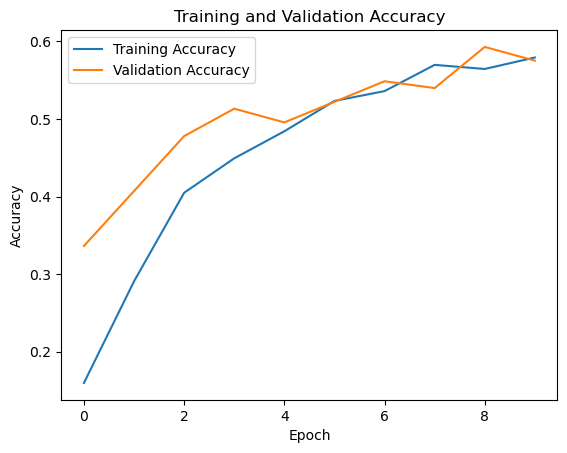

In [23]:
import matplotlib.pyplot as plt

plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

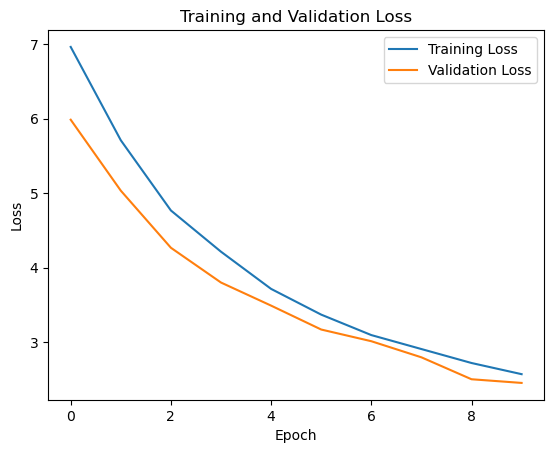

In [24]:
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

2/2 [==============================] - 1s 388ms/step


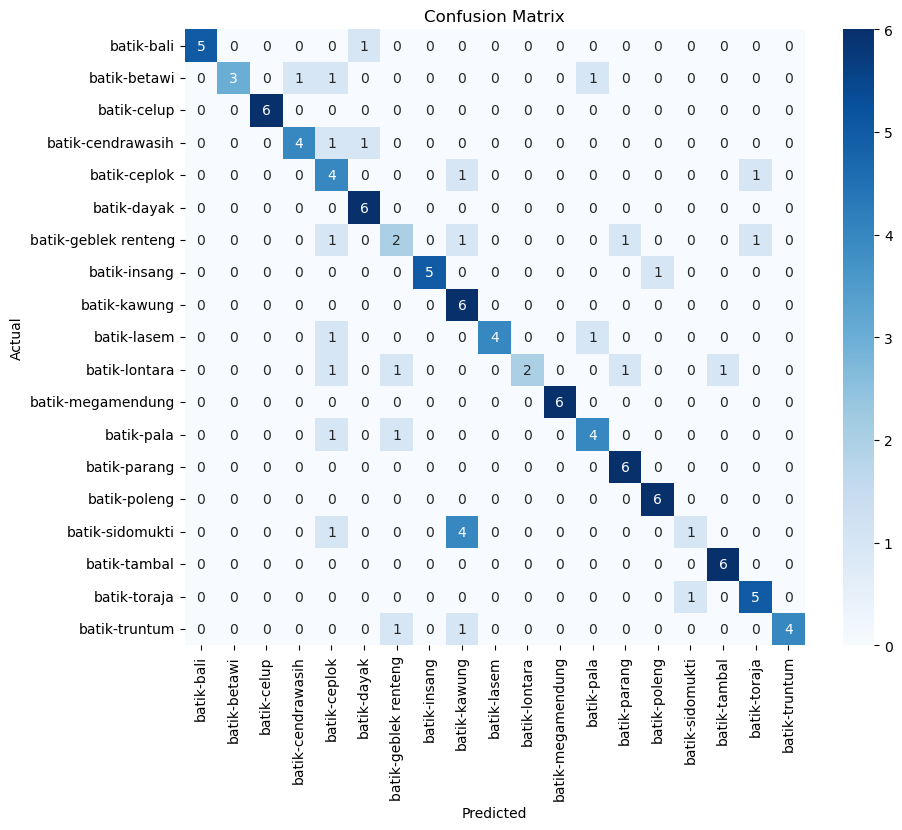

In [25]:
from sklearn.metrics import confusion_matrix, classification_report
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Mengambil prediksi dari data pengujian
Y_pred = model.predict(test_generator)
y_pred = np.argmax(Y_pred, axis=1)

# Membuat Confusion Matrix
cm = confusion_matrix(test_generator.classes, y_pred)

# Visualisasi Confusion Matrix
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=test_generator.class_indices.keys(), yticklabels=test_generator.class_indices.keys())
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

In [26]:
from tensorflow.keras.callbacks import LearningRateScheduler

# Learning rate scheduler function
def scheduler(epoch, lr):
    if epoch < 10:
        return lr
    else:
        return lr * 0.1  # Turunkan learning rate setelah 10 epoch

# Callback list with learning rate scheduler
callbacks = [
    EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True),
    ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=1e-6),
    LearningRateScheduler(scheduler)
]

# Fine-tuning lebih mendalam dengan epoch lebih banyak
with tf.device(GPU_DEVICE):
    history_fine = model.fit(train_generator,
                             epochs=30,  # Naikkan epoch untuk fine-tuning
                             validation_data=validation_generator,
                             callbacks=callbacks,
                             batch_size=BATCH_SIZE)

test_loss, test_accuracy = model.evaluate(test_generator)
print(f'Test Accuracy: {test_accuracy:.2f}')
print(f'Test Loss: {test_loss:.4f}')


Epoch 1/30
12/15 [=======================>......] - ETA: 3s - loss: 1.2803 - accuracy: 0.8698

C:\Users\fazan\.conda\envs\batik-env-3.10\lib\site-packages\PIL\Image.py:1056: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


15/15 [==============================] - 16s 1s/step - loss: 1.2708 - accuracy: 0.8774 - val_loss: 1.6239 - val_accuracy: 0.7345 - lr: 1.4013e-45
Epoch 2/30
15/15 [==============================] - 16s 1s/step - loss: 1.3169 - accuracy: 0.8362 - val_loss: 1.6234 - val_accuracy: 0.7345 - lr: 1.4013e-45
Epoch 3/30
15/15 [==============================] - 16s 1s/step - loss: 1.2933 - accuracy: 0.8499 - val_loss: 1.6229 - val_accuracy: 0.7345 - lr: 1.4013e-45
Epoch 4/30
15/15 [==============================] - 16s 1s/step - loss: 1.2726 - accuracy: 0.8636 - val_loss: 1.6222 - val_accuracy: 0.7345 - lr: 1.4013e-45
Epoch 5/30
15/15 [==============================] - 16s 1s/step - loss: 1.2959 - accuracy: 0.8488 - val_loss: 1.6217 - val_accuracy: 0.7345 - lr: 1.4013e-45
Epoch 6/30
15/15 [==============================] - 16s 1s/step - loss: 1.2775 - accuracy: 0.8499 - val_loss: 1.6210 - val_accuracy: 0.7345 - lr: 1.4013e-45
Epoch 7/30
15/15 [==============================] - 16s 1s/step - los

In [27]:
from sklearn.metrics import classification_report, confusion_matrix, f1_score, recall_score, precision_score
import numpy as np

# Prediksi pada data pengujian
Y_pred = model.predict(test_generator)
y_pred = np.argmax(Y_pred, axis=1)

# Menghitung Confusion Matrix
cm = confusion_matrix(test_generator.classes, y_pred)

# Laporan Klasifikasi (F1-Score, Precision, Recall)
print('Classification Report:')
print(classification_report(test_generator.classes, y_pred, target_names=test_generator.class_indices.keys()))

# Menghitung F1-Score, Precision, dan Recall secara keseluruhan (macro average)
f1 = f1_score(test_generator.classes, y_pred, average='macro')
recall = recall_score(test_generator.classes, y_pred, average='macro')
precision = precision_score(test_generator.classes, y_pred, average='macro')

print(f'Overall F1-Score: {f1:.2f}')
print(f'Overall Recall: {recall:.2f}')
print(f'Overall Precision: {precision:.2f}')

2/2 [==============================] - 1s 253ms/step
Classification Report:
                      precision    recall  f1-score   support

          batik-bali       1.00      0.83      0.91         6
        batik-betawi       1.00      0.50      0.67         6
         batik-celup       1.00      1.00      1.00         6
   batik-cendrawasih       0.80      0.67      0.73         6
        batik-ceplok       0.36      0.83      0.50         6
         batik-dayak       0.75      1.00      0.86         6
batik-geblek renteng       0.50      0.33      0.40         6
        batik-insang       1.00      0.83      0.91         6
        batik-kawung       0.50      1.00      0.67         6
         batik-lasem       1.00      0.50      0.67         6
       batik-lontara       1.00      0.33      0.50         6
   batik-megamendung       1.00      1.00      1.00         6
          batik-pala       0.71      0.83      0.77         6
        batik-parang       0.86      1.00      0.92    

#Model Epoch 20
